In [1]:
suppressPackageStartupMessages({
    library(Matrix)
    library(ggplot2)
    library(cygnus)
    library(dplyr)
    library(data.table)
    library(purrr)
    library(ggthemes)
    library(viridis)
    library(patchwork)
    library(glue)
    library(sf)
    library(ComplexHeatmap)
    library(RSpectra)
    library(mclust)
    library(Seurat)
    })

fig.size <- function(w,h) {
    options(repr.plot.height = h, repr.plot.width = w)
}


In [2]:
cells = readMM('data/VizgenLungHacohen/cells/counts.mtx')
genes = read.table('data/VizgenLungHacohen/cells/genes.txt', header=TRUE)
meta_data = read.table('data/VizgenLungHacohen/cells/meta_data.csv', sep=',', header=TRUE)

In [ ]:
meta_data

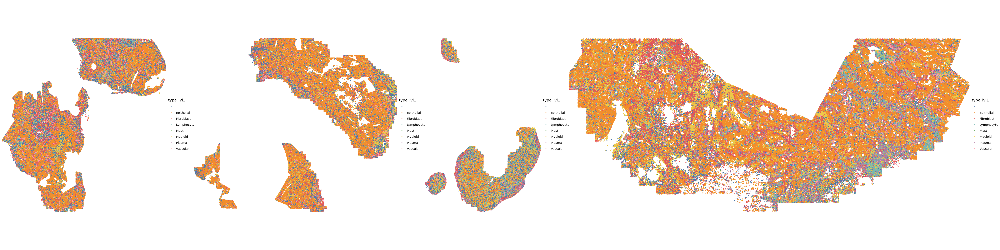

In [4]:
# Stratefied by patients


fig.size(10,40)
purrr::map(c('Patient001', 'Patient002', 'Sample04', 'Sample05'), function(i){
    ggplot() +
    geom_point(data = meta_data[meta_data$library==i,], aes(X, Y, color=type_lvl1), size=0.5) +
    theme_void() +
    scale_color_tableau() +
    coord_sf(expand = FALSE) +
    NULL
}) %>% purrr::reduce(`|`)

In [3]:
meta_patient1 = meta_data[meta_data$library=='Patient001',]
meta_patient2 = meta_data[meta_data$library=='Patient002',]
meta_sample4 = meta_data[meta_data$library=='Sample04',]
meta_sample5 = meta_data[meta_data$library=='Sample05',]

counts_patient1 = cells[,as.numeric(rownames(meta_patient1))]
counts_patient2 = cells[,as.numeric(rownames(meta_patient2))]
counts_sample4 = cells[,as.numeric(rownames(meta_sample4))]
counts_sample5 = cells[,as.numeric(rownames(meta_sample5))]

In [ ]:
table(meta_patient1$type_lvl1)

In [4]:
gettiles <- function(metadf, countsdf){
    res = GetTiles(
    metadf$X, metadf$Y, countsdf, metadf, c('type_lvl1', 'type_lvl2', 'hubID'),
    max_npts = 50,
    min_npts = 5,
    smooth_distance = 'projected', smooth_similarity = 'projected')
    return(res)
}


In [5]:
res1 = gettiles(meta_patient1, counts_patient1)
dmt1 = res1$dmt
aggs1 = res1$aggs

STEP 0: PREPARE DATA STRUCTURES

'as(<dgTMatrix>, "dgCMatrix")' is deprecated.
Use 'as(., "CsparseMatrix")' instead.
See help("Deprecated") and help("Matrix-deprecated").

STEP 1: GRADIENTS 

STEP 2: DMT

STEP 3: AGGREGATION



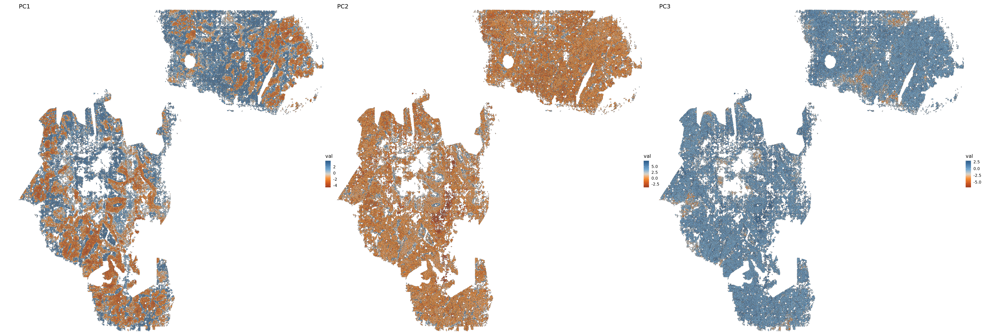

In [7]:
fig.size(45,15)
pca_plot = purrr::map(1:3, function(i) {
    ggplot(cbind(aggs1$meta_data, val=aggs1$pcs[, i])) +
        geom_sf(aes(geometry = shape, fill = val)) +
        theme_void(base_size = 16) +
        coord_sf(expand = FALSE) +
        scale_fill_gradient2_tableau() +
        guides(color = 'none') + 
        labs(title = glue('PC{i}')) +
        NULL
}) %>% purrr::reduce(`|`)
pca_plot

In [142]:
ggsave("outputs/patient1_pca.png", plot=pca_plot, width=45, height=15)

# Cluster and label titles

In [8]:
create_seurat_obj <- function(aggs){
    obj = Seurat::CreateSeuratObject(
    counts = aggs$counts,
    meta.data = tibble::column_to_rownames(data.frame(dplyr::select(aggs$meta_data, -shape)),'id')
    )
    # Add shape column to Seurat object based on aggs shape
    obj@meta.data$shape = aggs$meta_data$shape
    return(obj)
}

In [17]:
obj1 = create_seurat_obj(aggs1)

In [18]:
# Normal Seurat procedure
process_object <- function(obj){
    .verbose = FALSE
    obj = obj %>%
    NormalizeData(normalization.method  = 'LogNormalize', scale.factor = median(obj@meta.data$nCount_RNA), verbose=.verbose) %>%
    ScaleData(features = rownames(obj), verbose = .verbose) %>%
    RunPCA(npcs=20, features=rownames(obj), verbose=.verbose)  %>%
    RunUMAP(verbose=.verbose, dims=1:20) %>%
    Seurat::FindNeighbors(features=1:20, reduction='pca', verbose=.verbose) %>%
    Seurat::FindClusters(verbose=.verbose, resolution=c(0.8)) # The default option
    return(obj)
}

In [19]:
obj1 = process_object(obj1)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’



In [20]:
plot_umap_seurat_clusters <- function(obj, figsize=c(8,8)){
    p1 = DimPlot(obj1, reduction='umap', group.by='seurat_clusters') + scale_color_tableau("Classic 20")
    w = figsize[1]
    h = figsize[2]
    fig.size(w,h)
    p1
}
plot_tiles_seurat_clusters <- function(obj, title, figsize=c(25,25), legendsize=40, titlesize=40){
    p2 = ggplot(obj@meta.data) +
    geom_sf(aes(geometry=shape, fill=seurat_clusters)) +
    theme_void(base_size=16) +
    theme(legend.text=element_text(size=legendsize)) +
    theme(legend.title=element_text(size=legendsize),
         legend.key.size = unit(2, 'cm')) +
    coord_sf(expand=FALSE) +
    scale_fill_tableau("Classic 20") +
    ggtitle(title) +
    theme(plot.title=element_text(size=titlesize))
    NULL
    w = figsize[1]
    h = figsize[2]
    fig.size(w,h)
    
    return(p2)
    
    #plot_layout(widths = c(1,1))
}


In [21]:
p2 = plot_tiles_seurat_clusters(obj1, title='Patient1 tiles clustering', figsize=c(25,30), legendsize=40, titlesize=60)


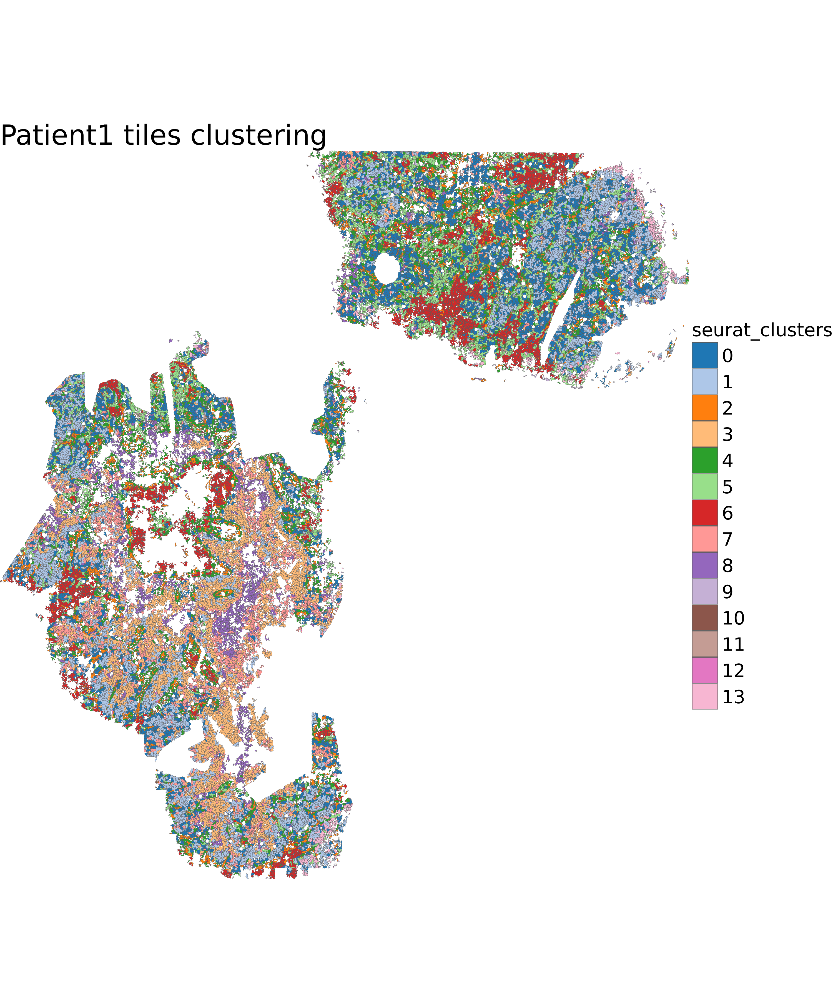

In [22]:
p2

In [23]:
head(obj1@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,X,Y,npts,area,perimeter,shape,RNA_snn_res.0.8,seurat_clusters
,<fct>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<GEOMETRY>,<fct>,<fct>
1,SeuratProject,1306,241,7065.793,-14.34093,49,3419.191,309.4606,POLYGON ((7036.463 14.26976...,13,13
2,SeuratProject,978,199,7087.885,82.53967,35,2390.596,380.9468,MULTIPOLYGON (((7067.08 101...,0,0
3,SeuratProject,1282,231,7132.785,124.68225,47,3160.053,494.5075,MULTIPOLYGON (((7135.462 94...,1,1
4,SeuratProject,815,192,7092.193,214.09269,28,2024.285,324.8041,POLYGON ((7108.945 211.6956...,13,13
5,SeuratProject,602,148,7105.959,274.35587,31,2531.373,545.4307,POLYGON ((7111.198 276.7631...,1,1
6,SeuratProject,754,193,7110.979,180.49872,33,2362.544,398.9924,POLYGON ((7145.487 160.2921...,1,1


In [24]:
dmt1$pts$spatial_cluster = obj1@meta.data$seurat_clusters[dmt1$pts$agg_id]

In [25]:
dmt1$pts

X,Y,ORIG_ID,type_lvl1,type_lvl2,hubID,f,agg_id,spatial_cluster
<dbl>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>
7086.414,79.414863586,1,Epithelial,Epithelial,H260,1.1896149,2,0
7087.515,-21.805605888,3,Epithelial,Epithelial,H260,1.0746909,1,13
7099.331,-17.703966141,4,Epithelial,Epithelial,H260,2.3223990,1,13
7100.477,-9.060024023,5,Epithelial,Epithelial,H260,1.2363504,1,13
7093.215,-5.783357859,6,Epithelial,Epithelial,H260,1.4256928,1,13
7086.925,-4.925822675,7,Epithelial,Epithelial,H260,1.4209250,3832,1
7093.836,4.836622715,8,Epithelial,Epithelial,H260,1.6776540,3832,1
7091.700,13.036805630,9,Epithelial,Epithelial,H260,1.3082215,3832,1
7099.888,27.607007980,10,Epithelial,Epithelial,H260,1.7632712,3832,1


In [26]:
saveRDS(dmt1, "outputs/dmt1.rds")

In [27]:
saveRDS(aggs1, "outputs/aggs1.rds")

In [128]:
ggsave(filename="outputs/patient1_tilecluster.png", plot=p2, width=25, height=30)

In [129]:
p1 = plot_umap_seurat_clusters(obj1)
ggsave(filename='outputs/patient1_umap.png', plot=p1, width=8, height=8)

In [55]:
# What are the percentage of each seurat cluster in the seurat object?
round(table(obj1@meta.data$seurat_clusters)*100/dim(obj1@meta.data)[1],2)


        0         1         2         3         4         5         6         7 
7.2359301 7.1204140 6.0576657 5.7989095 5.7896682 5.4708437 5.1889844 5.1473986 
        8         9        10        11        12        13        14        15 
5.0734683 5.0180205 4.9995379 4.3064412 3.7658257 3.7565844 3.4285186 3.3684502 
       16        17        18        19        20        21        22        23 
2.6892154 2.5413548 2.3657703 2.1809445 2.1439793 2.0192219 1.7974309 1.3446077 
       24        25 
0.7670271 0.6237871 

# Transfer agg information to cells

In [17]:
dmt1$pts$spatial_cluster = obj1@meta.data$seurat_clusters[dmt1$pts$agg_id]

In [198]:
plot_tile_celltype <- function(obj, dmt, title,titlesize=40, legendsize=30, figsize=c(25,30)){
    p1 = ggplot() +
    geom_sf(data = obj@meta.data, aes(geometry=shape), fill=NA) +
    geom_point(data=dmt$pts, aes(X,Y,color=type_lvl1), size=0.01) +
    scale_color_tableau('Classic 20') + 
    theme_void() +
    coord_sf(expand=FALSE) +
    ggtitle(title) +
    # Adjust title size
    theme(plot.title=element_text(size=titlesize)) +
    # Adjust legend size
    scale_color_tableau('Classic 20', guide = guide_legend(override.aes = list(size = 8)))+
    theme(legend.title=element_text(size=legendsize),
         legend.text=element_text(size=legendsize),
         legend.key.size=unit(2,'cm')) +
    NULL
    w = figsize[1]
    h = figsize[2]
    fig.size(w,h)
    
    return(p1)
}

In [199]:
p3 = plot_tile_celltype(obj1, dmt1, "Patient1 cell type composition")

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


In [224]:
ggsave("outputs/patient1_celltypecomp.png", plot=p3, width=25, height=30)

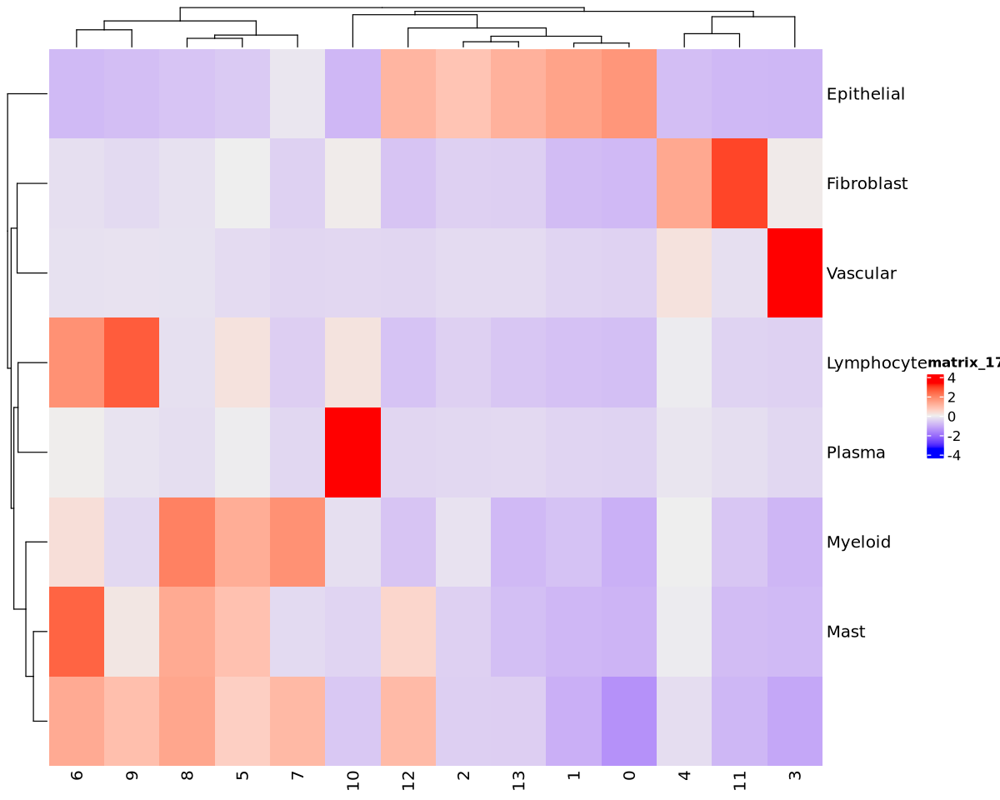

In [229]:
fig.size(10,8)
h1 = dmt1$pts %>%
    with(table(type_lvl1, spatial_cluster)) %>%
    prop.table(2) %>%
    t %>% scale %>% t %>%
    Heatmap()
h1

In [230]:
ggsave("outputs/patient1_broadtype.png", plot=h1, width=10, height=10)

ERROR: Error in x$theme: $ operator not defined for this S4 class


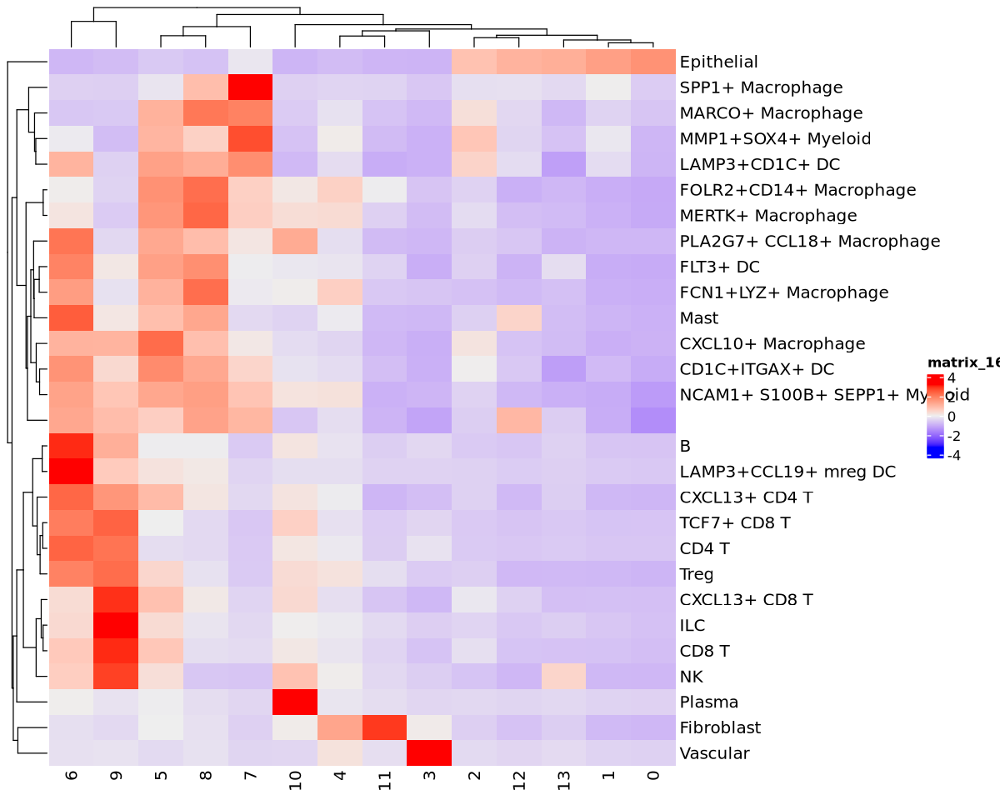

In [227]:
h2 = dmt1$pts %>% 
    with(table(type_lvl2, spatial_cluster)) %>% 
    prop.table(2) %>% 
    t %>% scale %>% t %>% 
    Heatmap()
h2

In [ ]:
ggsave("outputs/patient1_finetype.png", plot=p3, width=10, height=10)